In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

✅ Paths set up successfully.
loading annotations into memory...
Done (t=21.95s)
creating index...
index created!
Total COCO training images: 118287
Initial sample size: 20000
🔍 Verifying existence of image files...


Filtering images: 100%|██████████| 20000/20000 [00:58<00:00, 344.58it/s]



Removed 0 image IDs that were missing .jpg files.
Final sample size for processing: 20000


Creating first 50 masks: 100%|██████████| 50/50 [00:00<00:00, 89.58it/s]



✅ Successfully created and saved 50 masks to /kaggle/working/masks

🖼 Starting visualization for 50 images (Original vs. Masked Object)...


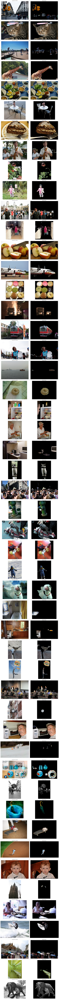


Visualization complete, showing only Original and Masked Objects.


In [5]:
from pycocotools.coco import COCO
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
import os
import random

# =======================================================
# 1. PATH SETUP (Using the suggested paths for a Kaggle/Colab environment)
# =======================================================

# *CRITICAL:* Adjust this path if you are not using Kaggle or your data is mounted elsewhere
data_base_dir = '/kaggle/input/coco-2017-dataset/coco2017' 
annFile = os.path.join(data_base_dir, 'annotations/instances_train2017.json')
imgDir = os.path.join(data_base_dir, 'train2017') # Directory containing the original .jpg images
saveMaskDir = '/kaggle/working/masks' # Writable directory to save the generated masks

os.makedirs(saveMaskDir, exist_ok=True)
print("✅ Paths set up successfully.")

# =======================================================
# 2. COCO Initialization
# =======================================================

try:
    coco = COCO(annFile)
except Exception as e:
    print(f"❌ Error loading COCO file. Check if {annFile} is correct.")
    print(e)
    exit()

imgIds = coco.getImgIds()
print("Total COCO training images:", len(imgIds))

random.seed(42)
all_sample_ids = random.sample(imgIds, 20000)
print("Initial sample size:", len(all_sample_ids))

# =======================================================
# 3. FIX: FILTERING OUT MISSING IMAGE IDs
# This prevents the "File(s) not found" warning by ensuring the .jpg exists.
# =======================================================
filtered_sample_ids = []
missing_count = 0

print("🔍 Verifying existence of image files...")
for img_id in tqdm(all_sample_ids, desc='Filtering images'):
    img_info = coco.loadImgs(img_id)[0]
    file_name = img_info['file_name']
    img_path = os.path.join(imgDir, file_name)

    if os.path.exists(img_path):
        filtered_sample_ids.append(img_id)
    else:
        missing_count += 1

# Update the sample list to only contain existing images
sample_ids = filtered_sample_ids 

print(f"\nRemoved {missing_count} image IDs that were missing .jpg files.")
print("Final sample size for processing:", len(sample_ids))

# =======================================================
# 4. MASK CREATION FUNCTION 
# =======================================================

def create_mask(coco, img_id, save_dir):
    """Generates a combined mask for all instances in an image and saves it."""
    ann_ids = coco.getAnnIds(imgIds=[img_id])
    anns = coco.loadAnns(ann_ids)
    img_info = coco.loadImgs(img_id)[0]
    
    mask = np.zeros((img_info['height'], img_info['width']), dtype=np.uint8)
    
    for ann in anns:
        mask = np.maximum(mask, coco.annToMask(ann) * 255)
        
    mask_path = os.path.join(save_dir, img_info['file_name'].replace('.jpg', '.png'))
    Image.fromarray(mask).save(mask_path)
    return img_info, mask_path

# =======================================================
# 5. MASK CREATION LOOP
# =======================================================

# Only create masks for the images we intend to visualize (the first 50)
N_IMAGES_TO_PROCESS = min(50, len(sample_ids))

for img_id in tqdm(sample_ids[:N_IMAGES_TO_PROCESS], desc=f'Creating first {N_IMAGES_TO_PROCESS} masks'):
    try:
        create_mask(coco, img_id, saveMaskDir)
    except Exception as e:
        print(f"\nError for image {img_id}: Mask creation failed due to annotation issue: {e}")

print(f"\n✅ Successfully created and saved {N_IMAGES_TO_PROCESS} masks to {saveMaskDir}")



   # =======================================================
# 6. VISUALIZATION (Updated for Original and Masked Object only)
# =======================================================

# Use the number of processed images for plotting
n_show = N_IMAGES_TO_PROCESS

# Create 50 rows and 2 columns (Original, Masked Object)
fig, axs = plt.subplots(n_show, 2, figsize=(12, n_show * 4)) # Reduced width from 18 to 12

print(f"\n🖼 Starting visualization for {n_show} images (Original vs. Masked Object)...")

for i, img_id in enumerate(sample_ids[:n_show]):
    img_info = coco.loadImgs(img_id)[0]

    img_path = os.path.join(imgDir, img_info['file_name'])
    mask_path = os.path.join(saveMaskDir, img_info['file_name'].replace('.jpg', '.png'))

    img_original = Image.open(img_path).convert('RGB')
    mask_binary = Image.open(mask_path).convert('L') # Load mask as single channel (L)

    # Convert images to numpy arrays for element-wise multiplication
    img_np = np.array(img_original)
    mask_np = np.array(mask_binary) / 255.0 # Normalize mask to 0.0 or 1.0

    # Expand mask_np to 3 channels to match img_np for broadcasting
    mask_3_channel = np.stack([mask_np, mask_np, mask_np], axis=-1)

    # Apply the mask: multiply the original image by the normalized mask
    masked_image_np = (img_np * mask_3_channel).astype(np.uint8)
    masked_image = Image.fromarray(masked_image_np)

    # Get the correct axes for the subplot
    ax_img_original = axs[i, 0]
    ax_masked = axs[i, 1]

    # Display Original Image
    ax_img_original.imshow(img_original)
    ax_img_original.axis('off')
    ax_img_original.set_title(f'Original (ID: {img_id})', fontsize=8)

    # Display Masked Image
    ax_masked.imshow(masked_image)
    ax_masked.axis('off')
    ax_masked.set_title('Masked Object', fontsize=8)

plt.tight_layout()
plt.show()

print("\nVisualization complete, showing only Original and Masked Objects.")